# Problem statement:
- Classifying if the exterior image belongs to a period or modern property in UK

# Modelling using VGG16
- Total number of images: 560


Model parameters:
- Dense layer: 128 neurons
- Dropout: 0.5
- Early Stopping: patience=2

Model results:
-  AUC: 97.6%, Accuracy(test): 90%

In [ ]:
from google.colab import drive
drive.mount('/content/drive/')

Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).


In [ ]:
# set min_size = 300
min_size = 300

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import re
from math import ceil
import random
import pickle

In [ ]:
from sklearn.model_selection import train_test_split, GridSearchCV
from sklearn.preprocessing import StandardScaler, LabelEncoder
from sklearn.metrics import roc_curve
from sklearn.metrics import auc

from skimage import io
from skimage import color
from skimage.transform import rescale, resize, downscale_local_mean

In [ ]:
from tensorflow.keras.applications.vgg16 import VGG16

In [ ]:
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras.layers import Dense, Dropout, Activation, Flatten
from tensorflow.keras.layers import Conv2D, MaxPooling2D
from tensorflow.keras.metrics import AUC
from tensorflow.keras.callbacks import EarlyStopping
from keras.wrappers.scikit_learn import KerasClassifier

In [ ]:
# For reproducibility
np.random.seed(42)

In [ ]:
# Colab path to replace the old root path
path = '/content/drive/MyDrive/Capstone/'
old_path = '../'

In [ ]:
# function to load folder into arrays and  then it returns that same array

def load_files(path):
    # Put files into lists and return them as one list of size 4
    image_files = os.listdir(path)
    image_files = [path + x for x in image_files]
    return image_files

In [ ]:
# feeding images into numpy ndarray

def load_array(image_files, min_size):
    X = np.array([])
    for file in image_files:
        try:
            img = io.imread(file)
            img_resized = resize(img, (min_size,min_size), anti_aliasing=True)
            if X.shape[0] == 0:
                X = np.array([img_resized])
            else:
                X = np.append(X, [img_resized], axis = 0)
        except:
            print("image error: ", file)
    return X



In [ ]:
def load_train_val(criteria, k):
    
    #default csv file of record
    csv = '../data/images_train_val.csv'

    # Added for Google Colab
    path = '/content/drive/MyDrive/Capstone/'
    old_path = '../'
    csv = csv.replace(old_path, path)

    df_images = pd.read_csv(csv, index_col=0)
    df_images.fillna(0, inplace=True)
    
   # Added for Google Colab
    df_images["image_link"] = [x.replace(old_path, path) for x in df_images["image_link"]]
    
    df_selected = df_images
    for key, value in criteria.items():
        df_selected = df_selected[df_selected[key]==value]
    
    if k>df_selected.shape[0]:
        print("Number of images is less than k")
    
    # use random.sample ie without replacement
    selected_index = random.sample(df_selected.index.to_list(), k)
    
    df_selected = df_selected.loc[selected_index]
    
    return df_selected

In [ ]:
def display_images(display_no, df_file_info):

    # displaty_no: must be multiples of 10
    # df: must have "image_link" as a field
   
    display_height = display_no/10*16

    fig, ax = plt.subplots(ceil(display_no/2), 2, figsize=(8,display_height))
    j=0
    for i in df_file_info.index[:display_no]:
        row = j//2
        col = j%2
        image_link = df_file_info.loc[i, "image_link"]
        property_id = re.findall('[0-9]{3}[0-9]+',image_link)[0]
        ax[row][col].imshow(io.imread(image_link))
        ax[row][col].axis('off')
        ax[row][col].set_title(property_id)
        j += 1

Load Exterior Period images

In [ ]:
# for unrepetitive images, set repeated=1, ie the first image occuring based on hash
# label = 0
criteria = {"ext":1., "new":0., "repeated":1}
k = 280
df_selected0 = load_train_val(criteria, k)
df_selected0.head()

,image_link,hash,repeated,ext,new
index,,,,,
1985,/content/drive/MyDrive/Capstone/images/old_mor...,0099fffffdd90808,1,1,0
2021,/content/drive/MyDrive/Capstone/images/old_mor...,ffff3f00d42c0020,1,1,0
2219,/content/drive/MyDrive/Capstone/images/old_sam...,fe7e6e6626363000,1,1,0
1828,/content/drive/MyDrive/Capstone/images/old_mor...,01d187833838dcff,1,1,0
1819,/content/drive/MyDrive/Capstone/images/old_mor...,00003ffbfd03fb7f,1,1,0


In [ ]:
# Check the uniqueness of list elements - set size should be equal to list size
len(set(df_selected0["image_link"])) == len(df_selected0["image_link"])

True

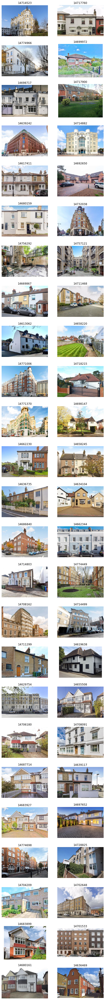

In [ ]:
df_file_info = df_selected0

display_no = 50
display_images(display_no, df_file_info)

Load Exterior Modern images

In [ ]:
# label = 1
# for unrepetitive images, set repeated=1, ie the first image occuring based on hash
criteria = {"ext":1., "new":1, "repeated":1}
k = 280
df_selected1 = load_train_val(criteria, k)
df_selected1.head()

,image_link,hash,repeated,ext,new
index,,,,,
779,/content/drive/MyDrive/Capstone/images/modern_...,7.08E+14,1,1,1
16,/content/drive/MyDrive/Capstone/images/modern_...,3d7f6c601c1c1f0f,1,1,1
299,/content/drive/MyDrive/Capstone/images/modern_...,0fefe7efefe40000,1,1,1
165,/content/drive/MyDrive/Capstone/images/modern_...,8fc7e3e3e1610000,1,1,1
4,/content/drive/MyDrive/Capstone/images/modern_...,073efffffb11e101,1,1,1


In [ ]:
# Check the uniqueness of list elements - set size should be equal to list size
len(set(df_selected1["image_link"])) == len(df_selected1["image_link"])

True

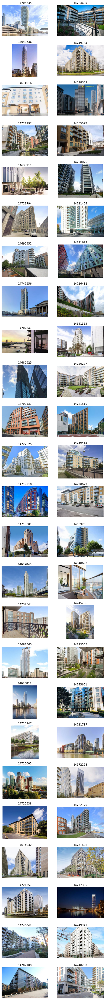

In [ ]:
df_file_info = df_selected1

display_no = 50
display_images(display_no, df_file_info)

Loading images as array

In [ ]:
# consolidating files of labels 0 and 1
df_all = pd.concat([df_selected0, df_selected1])
df_all.reset_index(drop=True, inplace=True)
df_all["id"] = df_all.index

In [ ]:
# loading images into array
X = load_array(df_all["image_link"], min_size)

/usr/local/lib/python3.7/dist-packages/PIL/TiffImagePlugin.py:788: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 2. 
  warnings.warn(str(msg))


In [ ]:
# Key step: assign the right label
# recording relevant link and labels
df_y = df_all[["id", "image_link", "new"]]
df_y.rename(columns={"new":"label"}, inplace=True)

print(df_y.shape)
df_y.head(5)

(560, 3)


/usr/local/lib/python3.7/dist-packages/pandas/core/frame.py:4308: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  errors=errors,


,id,image_link,label
0,0,/content/drive/MyDrive/Capstone/images/old_mor...,0
1,1,/content/drive/MyDrive/Capstone/images/old_mor...,0
2,2,/content/drive/MyDrive/Capstone/images/old_sam...,0
3,3,/content/drive/MyDrive/Capstone/images/old_mor...,0
4,4,/content/drive/MyDrive/Capstone/images/old_mor...,0


Checking against the first image in X and df_y

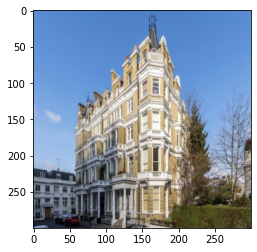

In [ ]:
plt.imshow(X[0])

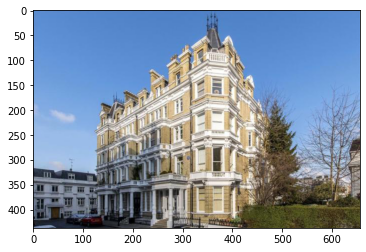

In [ ]:
plt.imshow(io.imread(df_y.iloc[0,1]))

Train test split

In [ ]:
# train test split
X_train, X_test, y_train, y_test = train_test_split(X, df_y, stratify=df_y["label"])
print(y_train.shape)

(420, 3)


In [ ]:
# Baseline accuracy - 50%
y_train['label'].value_counts()

1    210
0    210
Name: label, dtype: int64

In [ ]:
y_test.shape

(140, 3)

In [ ]:
y_test['id'][:10]

129    129
455    455
207    207
133    133
376    376
328    328
407    407
149    149
473    473
17      17
Name: id, dtype: int64

In [ ]:
y_test.iloc[0,1]

'/content/drive/MyDrive/Capstone/images/old_more/photo-14642947-MIthk7.jpg'

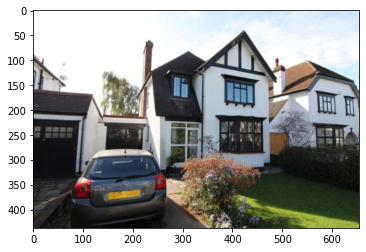

In [ ]:
plt.imshow(io.imread(y_test.iloc[0,1]))

Confirm if it is the right image corresponding to X_test 

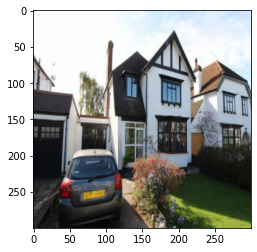

In [ ]:
plt.imshow(X_test[0])

Standard Scaling

In [ ]:
def image_std_train(X_train):
    X_train_flat = X_train.reshape(X_train.shape[0],-1)
    print(X_train_flat.shape)

    ss = StandardScaler()
    X_train_flat_ss = ss.fit_transform(X_train_flat)

    X_train_ss = X_train_flat_ss.reshape(X_train.shape)
    print(X_train_ss.shape)
        
    return ss, X_train_ss

def image_std_test(X_test, ss):
    X_test_flat = X_test.reshape(X_test.shape[0],-1)
    X_test_flat_ss = ss.transform(X_test_flat)
    X_test_ss = X_test_flat_ss.reshape(X_test.shape)
    
    return X_test_ss

In [ ]:
ss, X_train_ss = image_std_train(X_train)

(420, 270000)
(420, 300, 300, 3)


In [ ]:
X_test_ss = image_std_test(X_test, ss)

In [ ]:
y_test[['id','image_link']][:5]

,id,image_link
129,129,/content/drive/MyDrive/Capstone/images/old_mor...
455,455,/content/drive/MyDrive/Capstone/images/modern_...
207,207,/content/drive/MyDrive/Capstone/images/old_sam...
133,133,/content/drive/MyDrive/Capstone/images/old_sam...
376,376,/content/drive/MyDrive/Capstone/images/modern_...


Model - Transfer Learning

In [ ]:
BATCH_SIZE = 64
IMG_SIZE = (300, 300)

# Create the base model from the pre-trained model VGG16
IMG_SHAPE = IMG_SIZE + (3,)
input_model = VGG16(input_shape=IMG_SHAPE, include_top=False, weights='imagenet')

58892288/58889256 [==============================] - 1s 0us/step


In [ ]:
input_model.trainable=False

In [ ]:
# add new classifier layers
# add dropout = 0.5
flat1 = Flatten()(input_model.layers[-1].output)
class1 = Dense(128, activation='relu')(flat1)
class2 = Dropout(0.5)(class1)
output = Dense(1, activation='sigmoid')(class2)
# define new model
model = Model(inputs=input_model.inputs, outputs=output)

In [ ]:
print(model.summary())

Model: "model"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
input_1 (InputLayer)         [(None, 300, 300, 3)]     0         
_________________________________________________________________
block1_conv1 (Conv2D)        (None, 300, 300, 64)      1792      
_________________________________________________________________
block1_conv2 (Conv2D)        (None, 300, 300, 64)      36928     
_________________________________________________________________
block1_pool (MaxPooling2D)   (None, 150, 150, 64)      0         
_________________________________________________________________
block2_conv1 (Conv2D)        (None, 150, 150, 128)     73856     
_________________________________________________________________
block2_conv2 (Conv2D)        (None, 150, 150, 128)     147584    
_________________________________________________________________
block2_pool (MaxPooling2D)   (None, 75, 75, 128)       0     

In [ ]:
# early stopper
es = EarlyStopping(monitor='val_loss', mode='min', verbose=1, patience=3)

In [ ]:
model.compile(loss='binary_crossentropy',
                  optimizer='adam',
                  metrics=['accuracy'])

In [ ]:
# Fit model on training data
history = model.fit(X_train_ss,
                        y_train['label'],
                        batch_size=32,
                        validation_data=(X_test_ss, y_test['label']),
                        epochs=50,
                        verbose=1,
                        callbacks=[es])

Epoch 1/50
14/14 [==============================] - 506s 37s/step - loss: 3.3674 - accuracy: 0.5337 - val_loss: 0.3522 - val_accuracy: 0.8357
Epoch 2/50
14/14 [==============================] - 492s 36s/step - loss: 0.5656 - accuracy: 0.7549 - val_loss: 0.3902 - val_accuracy: 0.8214
Epoch 3/50
14/14 [==============================] - 491s 36s/step - loss: 0.3251 - accuracy: 0.8638 - val_loss: 0.3046 - val_accuracy: 0.8643
Epoch 4/50
14/14 [==============================] - 491s 36s/step - loss: 0.2158 - accuracy: 0.9231 - val_loss: 0.3053 - val_accuracy: 0.8643
Epoch 5/50
14/14 [==============================] - 492s 36s/step - loss: 0.1283 - accuracy: 0.9481 - val_loss: 0.3060 - val_accuracy: 0.8714
Epoch 6/50
14/14 [==============================] - 490s 36s/step - loss: 0.1230 - accuracy: 0.9604 - val_loss: 0.2705 - val_accuracy: 0.8786
Epoch 7/50
14/14 [==============================] - 490s 36s/step - loss: 0.1072 - accuracy: 0.9542 - val_loss: 0.2850 - val_accuracy: 0.8714
Epoch 

In [ ]:
model_tag = "vgg16c"

model_path = '/content/drive/MyDrive/Capstone/models/' + model_tag + '/'
model.save(model_path)

INFO:tensorflow:Assets written to: /content/drive/MyDrive/Capstone/models/vgg16b/assets


In [ ]:
# save the scaler
pickle.dump(ss, open('/content/drive/MyDrive/Capstone/models/' + model_tag + '/scaler.pkl', 'wb'))

Predictions based on the model

In [ ]:
y_pred = model.predict(X_test_ss)
y_pred.shape

(140, 1)

Area Under Curve (AUC)

In [ ]:
fpr_keras, tpr_keras, thresholds_keras = roc_curve(y_test["label"], y_pred)
auc_keras = auc(fpr_keras, tpr_keras)

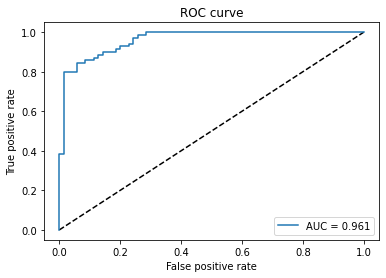

In [ ]:
plt.figure(1)
plt.plot([0, 1], [0, 1], 'k--')
plt.plot(fpr_keras, tpr_keras, label='AUC = {:.3f}'.format(auc_keras))
plt.xlabel('False positive rate')
plt.ylabel('True positive rate')
plt.title('ROC curve')
plt.legend(loc='best')
plt.show()

In [ ]:
y_test.loc[:,'pred'] = y_pred.round()
y_test.loc[:,'prob'] = y_pred.round(3)
y_test.head(10)

/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1596: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self.obj[key] = _infer_fill_value(value)
/usr/local/lib/python3.7/dist-packages/pandas/core/indexing.py:1734: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  isetter(loc, value[:, i].tolist())


,id,image_link,label,pred,prob
129,129,/content/drive/MyDrive/Capstone/images/old_mor...,0,0.0,0.002
455,455,/content/drive/MyDrive/Capstone/images/modern_...,1,1.0,1.000
207,207,/content/drive/MyDrive/Capstone/images/old_sam...,0,1.0,0.722
133,133,/content/drive/MyDrive/Capstone/images/old_sam...,0,0.0,0.064
376,376,/content/drive/MyDrive/Capstone/images/modern_...,1,1.0,0.965
328,328,/content/drive/MyDrive/Capstone/images/modern_...,1,1.0,0.999
407,407,/content/drive/MyDrive/Capstone/images/modern_...,1,1.0,0.993
149,149,/content/drive/MyDrive/Capstone/images/old_sam...,0,0.0,0.001
473,473,/content/drive/MyDrive/Capstone/images/modern_...,1,0.0,0.167
17,17,/content/drive/MyDrive/Capstone/images/old_sam...,0,0.0,0.003


Images properly classified

In [ ]:
# count the number of photos classified properly in y_test
y_test_classified = y_test[["image_link", "label", "pred", "prob"]][y_test["label"] == y_test["pred"]]

print(f"total number in y_test: {y_test.shape[0]}")
print(f"classified properly in y_test: {y_test_classified.shape[0]}")
y_test_classified.head()

print(f"accuracy: {round(y_test_classified.shape[0]/y_test.shape[0],3)}")


total number in y_test: 140
classified properly in y_test: 123
accuracy: 0.879


20


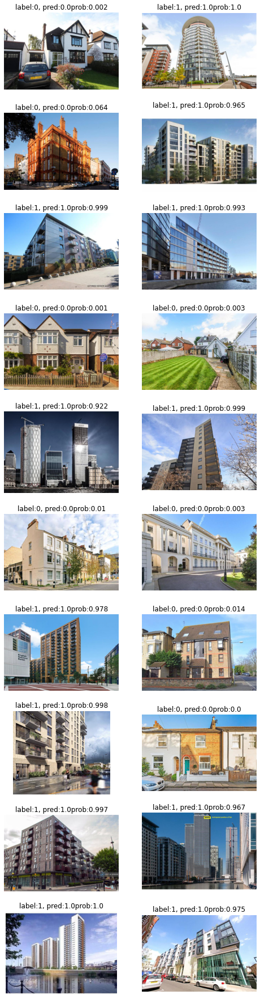

In [ ]:
# show the first 20 photos classified properly in y_test
display_no = min(20, y_test_classified.shape[0])

fig, ax = plt.subplots(ceil(display_no/2), 2, figsize=(8,32))
j=0
for i in y_test_classified.index[:display_no]:
    row = j//2
    col = j%2
    image_link = y_test_classified.loc[i, "image_link"]
    ax[row][col].imshow(io.imread(image_link))
    ax[row][col].set_title("label:" + str(y_test_classified.loc[i, "label"]) + ", pred:" + str(y_test_classified.loc[i, "pred"]) + "prob:"  + str(y_test_classified.loc[i, "prob"].round(3)))
    ax[row][col].axis('off')
    j += 1

print(j)

Images misclassified

In [ ]:
# count the number of photos misclassified in y_test
y_test_misclassified = y_test[["image_link", "label", "pred", "prob"]][y_test["label"] != y_test["pred"]]

print(f"total number in y_test: {y_test.shape[0]}")
print(f"misclassified in y_test: {y_test_misclassified.shape[0]}")
y_test_misclassified.head()

total number in y_test: 140
misclassified in y_test: 17


,image_link,label,pred,prob
207,/content/drive/MyDrive/Capstone/images/old_sam...,0,1.0,0.722
473,/content/drive/MyDrive/Capstone/images/modern_...,1,0.0,0.167
283,/content/drive/MyDrive/Capstone/images/modern_...,1,0.0,0.364
538,/content/drive/MyDrive/Capstone/images/modern_...,1,0.0,0.074
249,/content/drive/MyDrive/Capstone/images/old_sam...,0,1.0,0.998


17


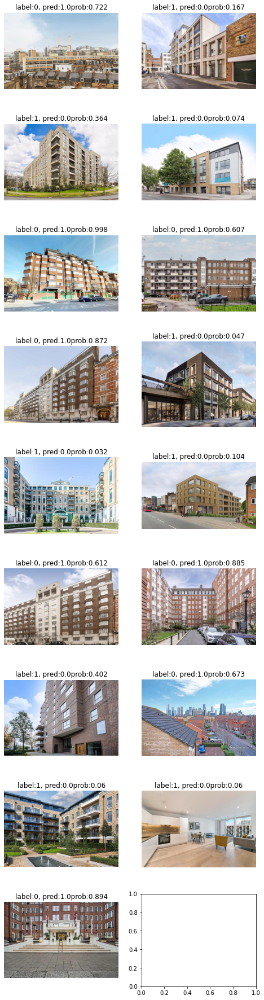

In [ ]:
# show the first n photos misclassified in y_test
display_no = min(30, y_test_misclassified.shape[0])

fig, ax = plt.subplots(ceil(display_no/2), 2, figsize=(8,32))
j=0
for i in y_test_misclassified.index[:display_no]:
    row = j//2
    col = j%2
    image_link = y_test_misclassified.loc[i, "image_link"]
    ax[row][col].imshow(io.imread(image_link))
    ax[row][col].set_title("label:" + str(y_test_misclassified.loc[i, "label"]) + ", pred:" + str(y_test_misclassified.loc[i, "pred"]) + "prob:"  + str(y_test_misclassified.loc[i, "prob"].round(3)))
    ax[row][col].axis('off')
    j += 1

print(j)

In [ ]:
def display_predictions(display_no, df_file_info):
    # displaty_no: must be multiples of 10
    # df: must have "image_link" as a field

    display_height = display_no/10*16

    fig, ax = plt.subplots(ceil(display_no/2), 2, figsize=(8,display_height))
    j=0
    for i in df_file_info.index[:min(display_no, df_file_info.shape[0])]:
        row = j//2
        col = j%2
        image_link = df_file_info.loc[i, "image_link"]
        property_id = re.findall('[0-9]{3}[0-9]+',image_link)[0]
        ax[row][col].imshow(io.imread(image_link))
        ax[row][col].axis('off')
        ax[row][col].set_title(property_id + ", label:" + str(df_file_info.loc[i, "label"]) + ", pred:" + str(round(df_file_info.loc[i, "pred"],0)) + ", prob:"  + str(round(df_file_info.loc[i, "prob"],2)))
        j += 1

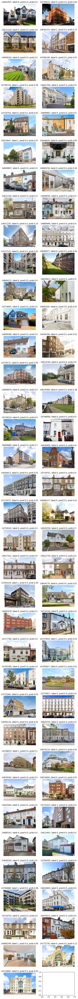

In [ ]:
# Classified as 0
y_test_classified0 = y_test[["image_link", "label", "pred", "prob"]][y_test["pred"]==0]

display_no = y_test_classified0.shape[0]
df_file_info = y_test_classified0

display_predictions(display_no, df_file_info)

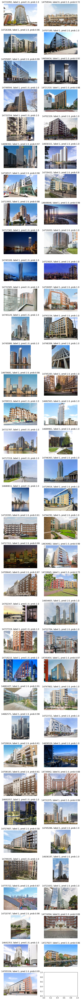

In [ ]:
# Classified as 1
y_test_classified1 = y_test[["image_link", "label", "pred", "prob"]][y_test["pred"]==1]

display_no = y_test_classified1.shape[0]
df_file_info = y_test_classified1

display_predictions(display_no, df_file_info)